In [9]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import numpy as np
import pandas as pd
from skimage.feature import hog
import cv2
import json
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error

# Figure 1 

In [10]:
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['figure.figsize'] = (16,9)

def plot_connections(layer1, layer2, names=None):
    for i, node in enumerate(layer1):
        for j, node2 in enumerate(layer2):
            plt.plot([node[0], node2[0]], [node[1], node2[1]], color='black')
            if names != None:
                plt.text((node[0] + node2[0])/2, (node[1] + node2[1])/2 + 0.1, names[i], zorder=11, color='grey', ha='center', fontsize=14)

def plot_nodes(nodes, names=None):
    for i, node in enumerate(nodes):
        plt.plot(node[0], node[1], marker='o', markersize=50, color='white', markeredgecolor='black', zorder=10)
        if (names != None) and (len(names) == len(nodes)):
            plt.text(node[0], node[1], names[i], zorder=11, ha='center', va='center', fontsize=14)


nn1_input_layer = [[1,3], [1,2]]
nn1_l1_layer = [[2,2.5]]
nn1_output_layer = [[3,2.5]]
plot_nodes(nn1_input_layer + nn1_l1_layer + nn1_output_layer, ['A', 'B', 'C', 'D'])
plot_connections(nn1_input_layer, nn1_l1_layer, ['W1', 'W2'])
plot_connections(nn1_l1_layer, nn1_output_layer, ['W3'])
plt.annotate('Input Node', (1,3.32), (1,4), ha='center', arrowprops=dict(arrowstyle='->', color='#0272a2'), fontsize=14, zorder=10)
plt.annotate('Perceptron', (2,2.82), (2,4), ha='center', arrowprops=dict(arrowstyle='->', color='#0272a2'), fontsize=14, zorder=10)
plt.annotate('Output Node', (3,2.82), (3,4), ha='center', arrowprops=dict(arrowstyle='->', color='#0272a2'), fontsize=14, zorder=10)

plt.text(1, 0.5, 'C = f(A*W1 + B*W1)\nD = f(C*W3)', fontsize=20)

nn2_input_layer = [[5.5,2], [5.5,3]]
nn2_l1_layer = [[6.5,1], [6.5,2], [6.5,3], [6.5,4]]
nn2_l2_layer = [[7.5,1], [7.5,2], [7.5,3], [7.5,4]]
nn2_output_layer = [[8.5,2.5]]
plot_nodes(nn2_input_layer + nn2_l1_layer + nn2_l2_layer + nn2_output_layer)
plot_connections(nn2_input_layer, nn2_l1_layer)
plot_connections(nn2_l1_layer, nn2_l2_layer)
plot_connections(nn2_l2_layer, nn2_output_layer)

df = pd.DataFrame(np.random.uniform(0, 1, (1000,2)), columns=['x','y'])

df['label'] = (df.x + df.y) > 1
plt.scatter(df[df.label].x*4, -df[df.label].y*4, color='C0', edgecolors='C0')
plt.scatter(df[~df.label].x*4, -df[~df.label].y*4, color='white', marker='s', edgecolors='C1')
plt.plot([0,4], [-4, 0], linewidth=4, color='black')

df['label'] = (np.sin(5*df.x) - 2 * df.y) > -0.9
plt.scatter(5+df[df.label].x*4, df[df.label].y*4-4, color='C0', edgecolors='C0')
plt.scatter(5+df[~df.label].x*4, df[~df.label].y*4-4, color='white', marker='s', edgecolors='C1')
plt.plot(5+np.arange(0, 4.0, 0.1), (np.sin(5 * np.arange(0, 4.0, 0.1) / 4) + 0.9) / 2 * 4 - 4, linewidth=4, color='black')

plt.ylim([-4.5, 4.5])
plt.axis(False);
plt.tight_layout(h_pad=0.1, w_pad=0.1);

plt.savefig('figures/001_neural_network_example.pdf')

In [11]:
plt.rcParams['figure.figsize'] = (7,7)
plt.rcParams['figure.dpi'] = 1200

one_dots = [[0,0],[1,0],[2,0],[1,0],[1,1],[1,2],[1,3],[1,4],[0,3]]
box = [[-0.2, -0.2], [-0.2, 1.2], [2.2, 1.2], [2.2, -0.2], [-0.2, -0.2]]
plt.plot([i[0] for i in one_dots], [i[1] for i in one_dots], linewidth=20, color='C0')

plt.plot([i[0]-4 for i in one_dots[:5]], [i[1]+3 for i in one_dots[:5]], linewidth=20, color='C1')
plt.plot([i[0]-4 for i in box], [i[1]+3 for i in box], color='C1')
plt.annotate('Example of a\nconvolutional filter', (-3, 2.82), (-3, 2), fontsize='xx-large', ha='center', va='center', arrowprops=dict(arrowstyle='->', color='C1'), color='C1', zorder=10)

plt.plot([i[0]+0.05 for i in one_dots[:5]], [i[1]-0.05 for i in one_dots[:5]], linewidth=20, alpha = 0.6, color='C2')
plt.plot([i[0]+0.05 for i in box], [i[1]-0.05 for i in box], color='C2')
plt.annotate('Strong overlap\nPositive output', (2.20, 0.5), (3, 0.5), fontsize='xx-large', va='center', arrowprops=dict(arrowstyle='->', color='C2'), color='C2', zorder=10)

plt.plot([i[0]-0.8 for i in one_dots[:5]], [i[1]+2 for i in one_dots[:5]], linewidth=20, alpha = 0.6, color='C3')
plt.plot([i[0]-0.8 for i in box], [i[1]+2 for i in box], color='C3')
plt.annotate('Low overlap\nNegative output', (1.35, 2.5), (3, 2.5), fontsize='xx-large', va='center', arrowprops=dict(arrowstyle='->', color='C3'), color='C3', zorder=10)

plt.axis(False);
plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/002_convolution_example.pdf')

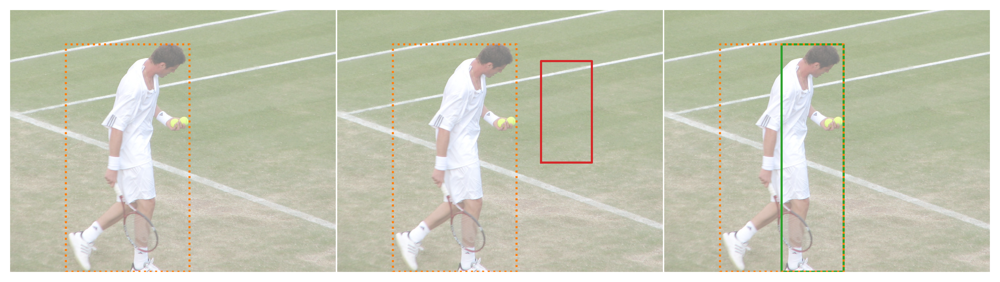

In [30]:
plt.rcParams['figure.figsize'] = (10,4)
plt.rcParams['figure.dpi'] = 1200

img = plt.imread('data/paper_default_image_420861.jpg')

true_box_1 = [[109, 515], [352, 515], [352, 67], [109, 67], [109, 515]]
pred_box_1 = [[400, 300], [500, 300], [500, 100], [400, 100], [400, 300]]
pred_box_2 = [[109+121, 515], [352, 515], [352, 67], [109+121, 67], [109+121, 515]]
plt.subplot(1,3,1)
plt.imshow(img, alpha=0.5)
plt.plot([i[0] for i in true_box_1], [i[1] for i in true_box_1], color='C1', linestyle=':')
plt.axis(False);
plt.subplot(1,3,2)
plt.imshow(img, alpha=0.5)
plt.plot([i[0] for i in pred_box_1], [i[1] for i in pred_box_1], color='C3')
plt.plot([i[0] for i in true_box_1], [i[1] for i in true_box_1], color='C1', linestyle=':')
plt.axis(False);
plt.subplot(1,3,3)
plt.imshow(img, alpha=0.5)
plt.plot([i[0] for i in pred_box_2], [i[1] for i in pred_box_2], color='C2')
plt.plot([i[0] for i in true_box_1], [i[1] for i in true_box_1], color='C1', linestyle=':')
plt.axis(False);

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/003_IOU_example.pdf')

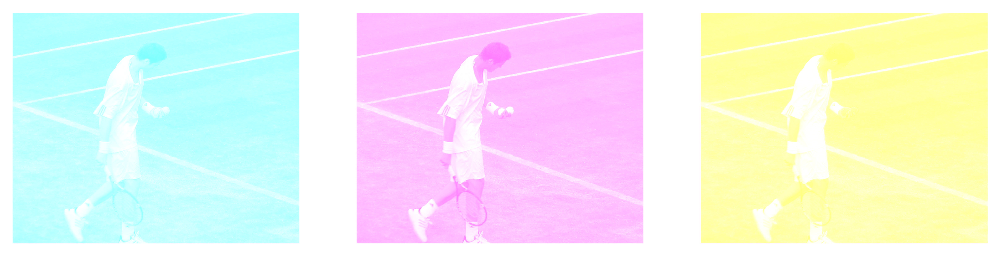

In [13]:
plt.rcParams['figure.figsize'] = (10,4)
plt.rcParams['figure.dpi'] = 1200

plt.subplot(1,3,1)
img = np.array(Image.open('data/paper_default_image_420861.jpg'))
for i in range(len(img)):
    for j in range(len(img[i])):
        img[i][j][1] = 255
        img[i][j][2] = 255
plt.imshow(img, alpha=0.5)
plt.axis(False)

plt.subplot(1,3,2)
img = np.array(Image.open('data/paper_default_image_420861.jpg'))
for i in range(len(img)):
    for j in range(len(img[i])):
        img[i][j][0] = 255
        img[i][j][2] = 255
plt.imshow(img, alpha=0.5)
plt.axis(False)

plt.subplot(1,3,3)
img = np.array(Image.open('data/paper_default_image_420861.jpg'))
for i in range(len(img)):
    for j in range(len(img[i])):
        img[i][j][0] = 255
        img[i][j][1] = 255
plt.imshow(img, alpha=0.5)
plt.axis(False)

plt.savefig('figures/EXTRA_channels.pdf')

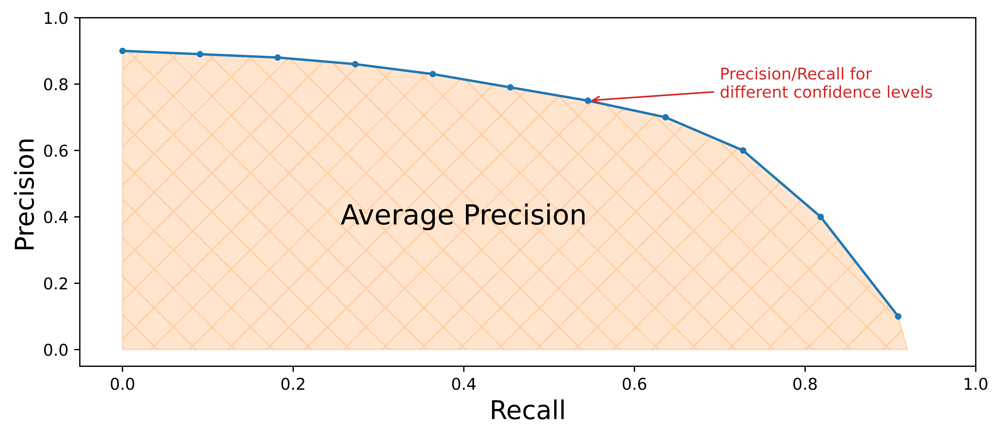

In [14]:
plt.rcParams['figure.figsize'] = (10,4)
plt.rcParams['figure.dpi'] = 1200

recalls = [0.9, 0.89, 0.88, 0.86, 0.83, 0.79, 0.75, 0.7, 0.60, 0.4, 0.1]
plt.plot(np.arange(0,1,(1/len(recalls))), recalls, marker='.')
# plt.plot(list(np.arange(0,1,(1/len(recalls)))) + [0.92, 0, 0], np.array(recalls + [0.03, 0.03, 0.9])-0.03)
plt.ylabel('Precision', fontsize=16)
plt.xlabel('Recall', fontsize=16)
plt.text(0.4, 0.4, 'Average Precision', fontsize='xx-large', ha='center', va='center', color='black')
plt.annotate('Precision/Recall for\ndifferent confidence levels', (6/11, 0.75), (0.7, 0.8), fontsize='medium', va='center', arrowprops=dict(arrowstyle='->', color='C3'), color='C3', zorder=10)

polygone = patches.Polygon(np.column_stack([list(np.arange(0,1,(1/len(recalls)))) + [0.92, 0, 0], np.array(recalls + [0, 0, 0.87])]), color='C1', alpha=0.2, hatch='x')
plt.gcf().gca().add_artist(polygone)

plt.ylim([-0.05,1])
plt.xlim([-0.05,1])
plt.savefig('figures/004_average_precision_example.pdf')

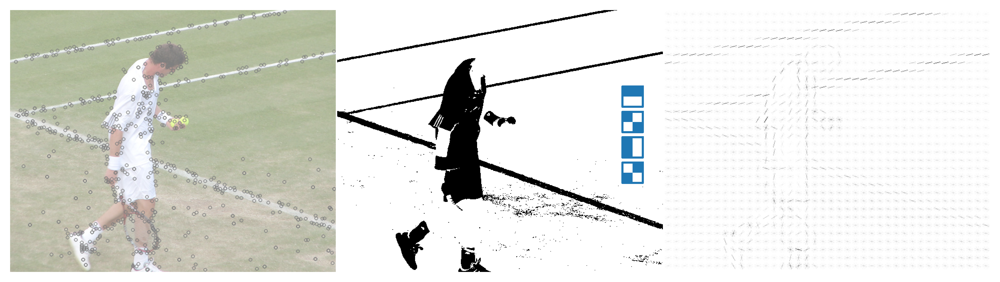

In [38]:
plt.rcParams['figure.figsize'] = (10,4)
plt.rcParams['figure.dpi'] = 1200

img = cv2.imread('data/paper_default_image_420861.jpg')  
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.subplot(1,3,1)
# See https://www.analyticsvidhya.com/blog/2019/10/detailed-guide-powerful-sift-technique-image-matching-python/
sift = cv2.xfeatures2d.SIFT_create()
keypoints_1, descriptors_1 = sift.detectAndCompute(img,None)
sift_img = cv2.drawKeypoints(img,keypoints_1,img.copy(),color=(0,0,0))
plt.imshow(cv2.cvtColor(sift_img, cv2.COLOR_BGR2RGB), alpha=0.5)
plt.axis(False);

plt.subplot(1,3,2)
(_, haar_img) = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
plt.imshow(255-cv2.cvtColor(haar_img, cv2.COLOR_BGR2RGB))

plt.plot([600, 600, 560, 560, 600], [150, 190, 190, 150, 150], color='C0')
plt.plot([600, 600, 560, 560, 600], [200, 240, 240, 200, 200], color='C0')
plt.plot([600, 600, 560, 560, 600], [250, 290, 290, 250, 250], color='C0')
plt.plot([600, 600, 560, 560, 600], [300, 340, 340, 300, 300], color='C0')
plt.gcf().gca().add_artist(patches.Rectangle((560, 150), 40, 20))
plt.gcf().gca().add_artist(patches.Rectangle((560, 200), 20, 20))
plt.gcf().gca().add_artist(patches.Rectangle((580, 220), 20, 20))
plt.gcf().gca().add_artist(patches.Rectangle((560, 250), 20, 40))
plt.gcf().gca().add_artist(patches.Rectangle((580, 300), 20, 20))
plt.gcf().gca().add_artist(patches.Rectangle((560, 320), 20, 20))
plt.axis(False);

plt.subplot(1,3,3)
# See https://www.thepythoncode.com/article/hog-feature-extraction-in-python
_, hog_image = hog(img, orientations=8, pixels_per_cell=(16, 16),
                	cells_per_block=(16, 16), visualize=True, multichannel=True)
plt.imshow(255-hog_image, cmap="binary_r")
plt.axis(False);

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/005_non_deep_example.pdf')

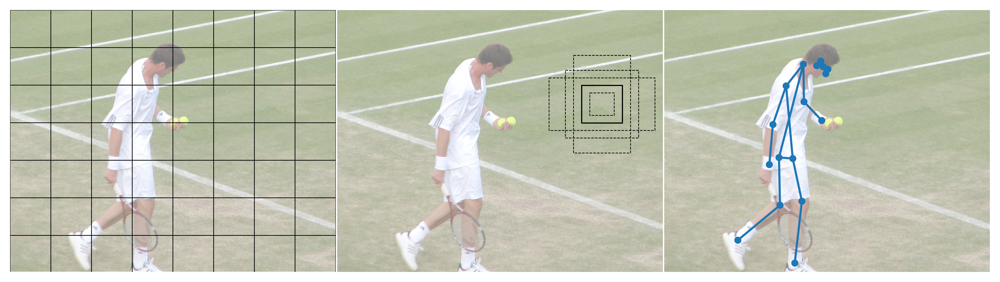

In [16]:
plt.rcParams['figure.figsize'] = (10,4)
plt.rcParams['figure.dpi'] = 1200

img = plt.imread('data/paper_default_image_420861.jpg')

plt.subplot(1,3,1)
plt.imshow(img, alpha=0.5)
for i in range(641):
    if i % 80 == 0:
        plt.axvline(i, linewidth=0.5, color='black')
for i in range(520):
    if i % 74 == 0:
        plt.axhline(i, linewidth=0.5, color='black')
plt.xlim([0,640])
plt.ylim([516,0])
plt.axis(False);

plt.subplot(1,3,2)
plt.imshow(img, alpha=0.5)
plt.plot(80 * np.array([6, 7, 7, 6, 6]), 74 * np.array([2, 2, 3, 3, 2]), color='black', linewidth=0.8)
plt.plot(80 * np.array([6.2, 6.8, 6.8, 6.2, 6.2]), 74 * np.array([2.2, 2.2, 2.8, 2.8, 2.2]), color='black', linestyle='--', linewidth=0.5)
plt.plot(80 * np.array([5.6, 7.4, 7.4, 5.6, 5.6]), 74 * np.array([1.6, 1.6, 3.4, 3.4, 1.6]), color='black', linestyle='--', linewidth=0.5)
plt.plot(80 * np.array([5.2, 7.8, 7.8, 5.2, 5.2]), 74 * np.array([1.8, 1.8, 3.2, 3.2, 1.8]), color='black', linestyle='--', linewidth=0.5)
plt.plot(80 * np.array([5.8, 7.2, 7.2, 5.8, 5.8]), 74 * np.array([1.2, 1.2, 3.8, 3.8, 1.2]), color='black', linestyle='--', linewidth=0.5)
plt.axis(False);

plt.subplot(1,3,3)
plt.imshow(img, alpha=0.5)
limbs = {
        'nose':[317,125],  'left_eye':[312,111],  'right_eye':[321,116],  'left_ear':[307,100],  'right_ear':[299,109],  'left_shoulder':[273,106],  'right_shoulder':[239,149],  'left_elbow':[274,180], 'right_elbow':[213,225],  'left_wrist':[309,217],  'right_wrist':[206,304],  'left_hip':[225,290],  'right_hip':[252,292],  'left_knee':[227,384],  'right_knee':[270,376],  'left_ankle':[144,453],  'right_ankle':[256,498]
}

chain_face = ['left_ear', 'left_eye', 'nose', 'right_eye', 'right_ear']
chain_arm = ['left_wrist', 'left_elbow', 'left_shoulder', 'right_shoulder', 'right_elbow', 'right_wrist']
chain_back1 = ['left_shoulder', 'left_hip']
chain_back2 = ['right_shoulder', 'right_hip']
chain_legs = ['left_ankle', 'left_knee', 'left_hip', 'right_hip', 'right_knee', 'right_ankle']

plt.plot([i[0] for i in [limbs[limb] for limb in chain_face]], [i[1] for i in [limbs[limb] for limb in chain_face]], color='C0', marker='o', markersize=4)
plt.plot([i[0] for i in [limbs[limb] for limb in chain_arm]], [i[1] for i in [limbs[limb] for limb in chain_arm]], color='C0', marker='o', markersize=4)
plt.plot([i[0] for i in [limbs[limb] for limb in chain_back1]], [i[1] for i in [limbs[limb] for limb in chain_back1]], color='C0', marker='o', markersize=4)
plt.plot([i[0] for i in [limbs[limb] for limb in chain_back2]], [i[1] for i in [limbs[limb] for limb in chain_back2]], color='C0', marker='o', markersize=4)
plt.plot([i[0] for i in [limbs[limb] for limb in chain_legs]], [i[1] for i in [limbs[limb] for limb in chain_legs]], color='C0', marker='o', markersize=4)

plt.axis(False);

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/006_object_concepts_example.pdf')

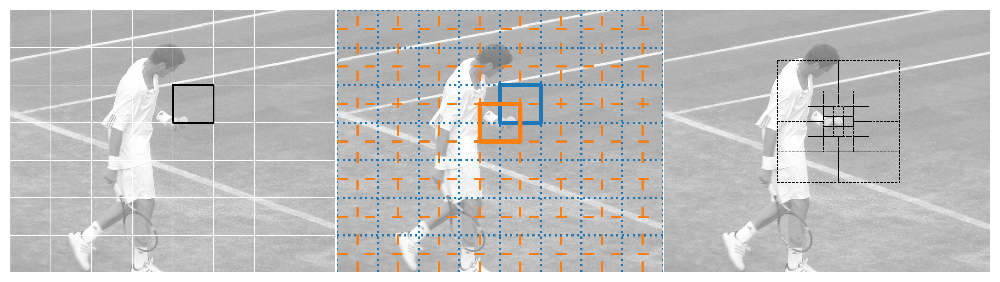

In [17]:
plt.rcParams['figure.figsize'] = (10,4)
plt.rcParams['figure.dpi'] = 1200

img = plt.imread('data/paper_default_image_420861.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(gray, cv2.COLOR_BGR2RGB), alpha=0.5)
for i in range(641):
    if i % 80 == 0:
        plt.axvline(i, linewidth=0.5, color='white')
for i in range(520):
    if i % 74 == 0:
        plt.axhline(i, linewidth=0.5, color='white')

plt.plot(80 * np.array([4, 5, 5, 4, 4]), 74 * np.array([2, 2, 3, 3, 2]), color='black', linewidth=1.2)

plt.xlim([0,640])
plt.ylim([516,0])
plt.axis(False);

plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(gray, cv2.COLOR_BGR2RGB), alpha=0.5)
for i in range(641):
    if i % 80 == 0:
        plt.axvline(i, color='C0', linestyle=':')
        plt.axvline(i+40, color='C1', linestyle=(0, (5, 8)))
for i in range(520):
    if i % 74 == 0:
        plt.axhline(i, color='C0', linestyle=':')
        plt.axhline(i+37, color='C1', linestyle=(0, (5, 8)))

plt.plot(80 * np.array([4, 5, 5, 4, 4]), 74 * np.array([2, 2, 3, 3, 2]), color='C0', linewidth=3)
plt.plot(80 * np.array([4, 5, 5, 4, 4])-40, 74 * np.array([2, 2, 3, 3, 2])+37, color='C1', linewidth=3)

plt.xlim([0,640])
plt.ylim([516,0])
plt.axis(False);

plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(gray, cv2.COLOR_BGR2RGB), alpha=0.5)
plt.gcf().gca().add_artist(patches.Rectangle((332, 209), 20, 20, fill=False))
for i in range(3):
    for j in range(3):
        plt.gcf().gca().add_artist(patches.Rectangle((312+20*i, 189+20*j), 20, 20, fill=False, linestyle='--', linewidth=0.5))
for i in range(4):
    for j in range(4):
        if j in [0,3] or i in [0,3]:
            plt.gcf().gca().add_artist(patches.Rectangle((282+30*i, 159+30*j), 30, 30, fill=False, linestyle='--', linewidth=0.5))
for i in range(4):
    for j in range(4):
        if j in [0,3] or i in [0,3]:
            plt.gcf().gca().add_artist(patches.Rectangle((222+60*i, 99+60*j), 60, 60, fill=False, linestyle='--', linewidth=0.5))
plt.axis(False);

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/007_attention_concepts_example.pdf');

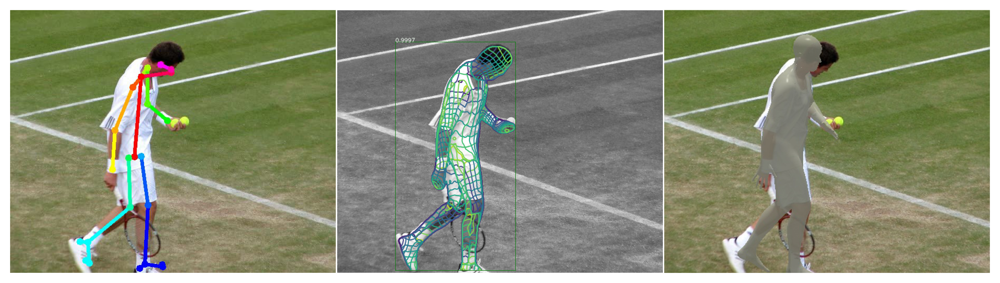

In [18]:
plt.rcParams['figure.figsize'] = (10,4)
plt.rcParams['figure.dpi'] = 1200

plt.subplot(1,3,1)
plt.imshow(plt.imread('data/paper_default_image_420861_openpose.jpg'))
plt.axis(False);

plt.subplot(1,3,2)
plt.imshow(plt.imread('data/paper_default_image_420861_densepose.png'))
plt.axis(False);

plt.subplot(1,3,3)
plt.imshow(plt.imread('data/paper_default_image_420861_romp.jpg'))
plt.axis(False);

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/008_keypoint_example.pdf');

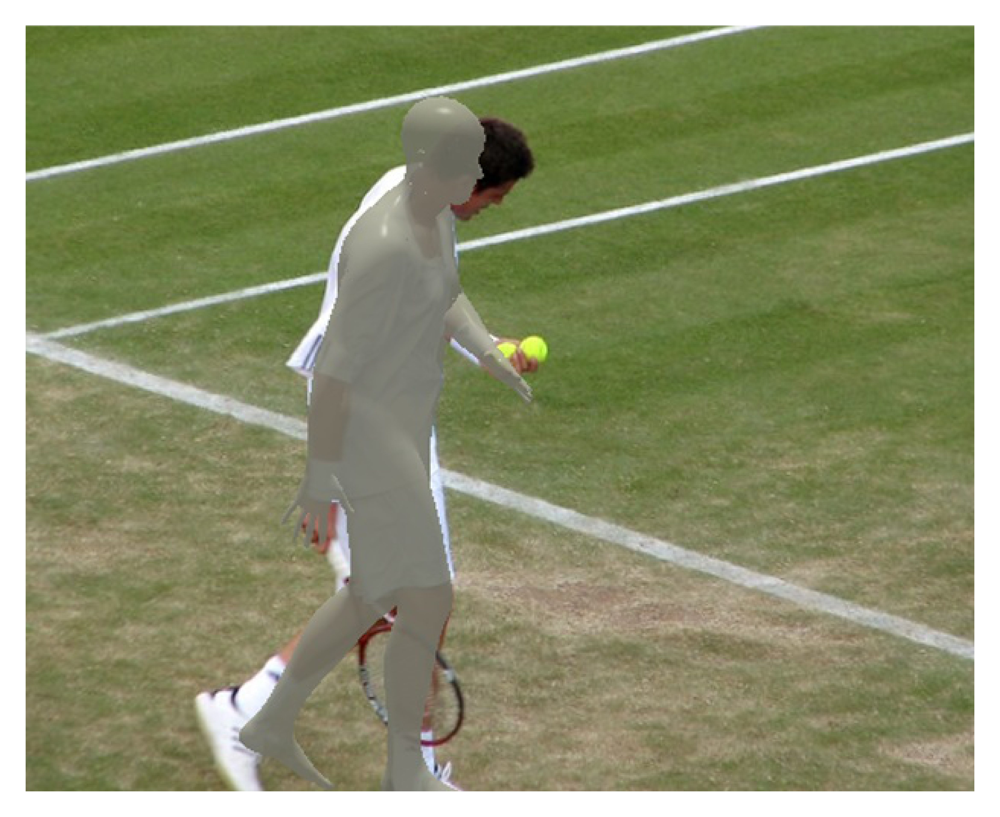

In [19]:
plt.rcParams['figure.figsize'] = (4,4)
plt.rcParams['figure.dpi'] = 1200

plt.imshow(plt.imread('data/paper_default_image_420861_romp.jpg'))
plt.axis(False);

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/009_3d_mesh_example.pdf');

In [21]:
# Setup
plt.rcParams['figure.figsize'] = (12,4)
plt.rcParams['figure.dpi'] = 1200

plt.subplot(1,2,1)
plt.imshow(plt.imread('data/capture_example.png'))
plt.axis(False);

plt.subplot(1,2,2)
plt.plot([1, 1, 4, 4], [1, 3, 3, 1], color='Black')
plt.plot([0, 5], [1, 1], color='C2')
plt.scatter(2.5, -2, color='C4')
plt.scatter([1.75, 3.25], [2, 2], color='C1')
plt.scatter([1.1, 3.9], [2.9, 2.9], color='C3')
plt.plot([2.5, 1.75], [-2, 2], linestyle='--')
plt.plot([1.75, 1.75, 2.5, 2.5], [2, 1, 1, -2], linestyle='--')

plt.text(2.5, -0.5, ' 6 meters', color='C1')
plt.text(2, 1.05, '0.75', color='C1')
plt.text(1.6, 1.4, '1', color='C1')
plt.annotate('Average Trajectory', (2.1,0), (1, 0), ha='center', va='center', arrowprops=dict(arrowstyle='->', color='#0272a2'), zorder=10) #fontsize
plt.axis(False);

plt.plot([1, 4], [3.1, 3.1], color='C1', marker='.')
plt.text(2.5, 3.15, '3', color='C1')
plt.plot([4.05, 4.05], [1, 3], color='C1', marker='.')
plt.text(4.1, 2, '2', color='C1', va='center')


plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/010_experimental_setup.pdf');

In [22]:
angle_ids = {
    'right_knee': ['right_ankle', 'right_hip'],
    'left_knee': ['left_ankle', 'left_hip'],
    'right_hip': ['right_knee', 'right_shoulder'],
    'left_hip': ['left_knee', 'left_shoulder'],
    'right_shoulder': ['right_hip', 'right_elbow'],
    'left_shoulder': ['left_hip', 'left_elbow'],
    'right_elbow': ['right_shoulder', 'right_wrist'],
    'left_elbow': ['left_shoulder', 'left_wrist'],
    'right_ankle':['right_foot', 'right_knee'],
    'left_ankle':['left_foot', 'left_knee'],
    'hip':['left_hip', 'right_hip']
    }

limbs_3d = {
        'left_hand':22, 'left_wrist':20, 'left_elbow':18, 'left_shoulder':16, 'left_back':13,
        'right_hand':23, 'right_wrist':21, 'right_elbow':19, 'right_shoulder':17, 'right_back':14,
        'nose':15, 'neck':12, 'upper_back':9, 'back':6, 'lower_back':3, 'hip':0,
        'left_hip':1, 'left_knee':4, 'left_ankle':7, 'left_foot': 10,
        'right_hip':2, 'right_knee':5, 'right_ankle':8, 'right_foot': 11
}
limbs_3d_r = {i: j for j, i in limbs_3d.items()}

limbs = {
        'nose':0, 'left_eye':1, 'right_eye':2, 'left_ear':3, 'right_ear':4, 'left_shoulder':5, 'right_shoulder':6, 'left_elbow':7,
        'right_elbow':8, 'left_wrist':9, 'right_wrist':10, 'left_hip':11, 'right_hip':12, 'left_knee':13, 'right_knee':14,
        'left_ankle':15, 'right_ankle':16
}
limbs_r = {i: j for j, i in limbs.items()}

In [23]:
data = json.load(open('data/tab/joined/data.json', 'r'))
res_2d = pd.read_csv('results/res_2d.csv')
res_3d = pd.read_csv('results/res_3d.csv')

In [24]:
dfs_to_concat = []
data_speed = []
for key in list(data.keys()):
    df_ = pd.DataFrame(data[key]['ball'], columns=['y0','x0', 'y1', 'x1'])
    df_['it'] = df_.index
    df_['key'] = int(key)

    df_['x'] = (df_.x0 + df_.x1) / 2
    df_['y'] = -(df_.y0 + df_.y1) / 2 + 1
    df_['area'] = (df_.x0 - df_.x1) * (df_.y0 - df_.y1)
    
    dfs_to_concat.append(df_)

    # Calculating ball speed
    ## Remove iterations where the ball is inside the goal
    df_ = df_.loc[df_.x < 0.72]
    ## Remove iterations where the size of the ball reduces substantially (ball occluded)
    df_ = df_[~((df_.x.rolling(10000, min_periods=0).max() > 0.66) & (df_.area < (df_.area.shift(1) * 0.8)))]
    ## Remove iterations where the ball is close to the goal and then goes back
    df_ = df_[~((df_.x.rolling(10000, min_periods=0).max() > 0.66) & (df_.x < df_.x.rolling(10000, min_periods=0).max()))]

    data_speed.append([int(key), len(df_), 6.128825336065631 / (len(df_)/90), 6.128825336065631 / (len(df_)/90) * 3.6, df_.y.iloc[-1]])

df_ball_speed = pd.DataFrame(data_speed, columns=['key', 'n_frames', 'speed_ms', 'speed_kmh', 'last_frame_height'])
df_ball = pd.concat(dfs_to_concat)

In [25]:
plt.rcParams['figure.figsize'] = (16,9)
plt.rcParams['figure.dpi'] = 1200
from random import random

for i, shot in enumerate([k for k in list(df_ball_speed.sort_values('last_frame_height').key) if str(k)[0] == '4']):
    ball_df = pd.DataFrame(data[str(shot)]['ball'], columns=['y0','x0', 'y1', 'x1'])

    ball_df['x'] = (ball_df.x0 + ball_df.x1) / 2
    ball_df['y'] = -(ball_df.y0 + ball_df.y1) / 2 + 1
    ball_df['area'] = (ball_df.x0 - ball_df.x1) * (ball_df.y0 - ball_df.y1)

    plt.plot(ball_df.x, ball_df.y, marker = 'o', linewidth=2, color = f'C{i}', alpha=0.13)

    ball_df = ball_df[ball_df.x < 0.75]
    ball_df = ball_df[~((ball_df.x.rolling(10000, min_periods=0).max() > 0.66) & (ball_df.x < ball_df.x.rolling(10000, min_periods=0).max()))]
    ball_df = ball_df[~((ball_df.x.rolling(10000, min_periods=0).max() > 0.66) & (ball_df.area < (ball_df.area.shift(1) * 0.8)))]
    ball_df = ball_df[~((ball_df.x.rolling(10000, min_periods=0).max() > 0.66) & (ball_df.x.diff() < 0.005))]
    plt.plot(ball_df.x, ball_df.y, marker = 'o', linewidth=2, color = f'C{i}')

    plt.text(0.75, 0.38 + i/28, 
        f'     {round(6.265/(len(ball_df)/90),2)}m/s - {round(6/(len(ball_df)/90) * 3.6,2)}km/h', va='center', size='large', color = f'C{i}')
    plt.plot([ball_df.x.iloc[-1], 0.76], [ball_df.y.iloc[-1], 0.38 + i/28], color = f'C{i}', marker='s', linestyle=':')

plt.ylim([0.3, 1.0])
plt.axis(False);
plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/011_ball_trajectories.pdf');

In [26]:
key = '103'
df = pd.DataFrame([sum(i, []) for i in data[key]['pose']], columns=sum([[limbs_3d_r[i] + '_x', limbs_3d_r[i] + '_y', limbs_3d_r[i] + '_z'] for i in range(len(limbs_3d_r.keys()))], []))

df['va_x'] = df['right_ankle_x'] - df['right_hip_x']
df['va_y'] = df['right_ankle_y'] - df['right_hip_y']
df['va_z'] = df['right_ankle_z'] - df['right_hip_z']
df['vb_x'] = df['right_ankle_x'] - df['right_hip_x']
df['vb_y'] = df['right_ankle_y'] - df['right_hip_y']
df['vb_z'] = df['right_ankle_z'] - df['right_hip_z']

df['right_ankle_angle'] = np.arccos((df.va_x * df.vb_x + df.va_y * df.vb_y + df.va_z * df.vb_z) / (np.sqrt((df.va_x ** 2) + (df.va_y ** 2) + (df.va_z ** 2)) + np.sqrt((df.vb_x ** 2) + (df.vb_y ** 2) + (df.vb_z ** 2))))
df['right_ankle_angle_rol'] = df['right_ankle_angle'].rolling(5).mean().diff().rolling(5).mean()

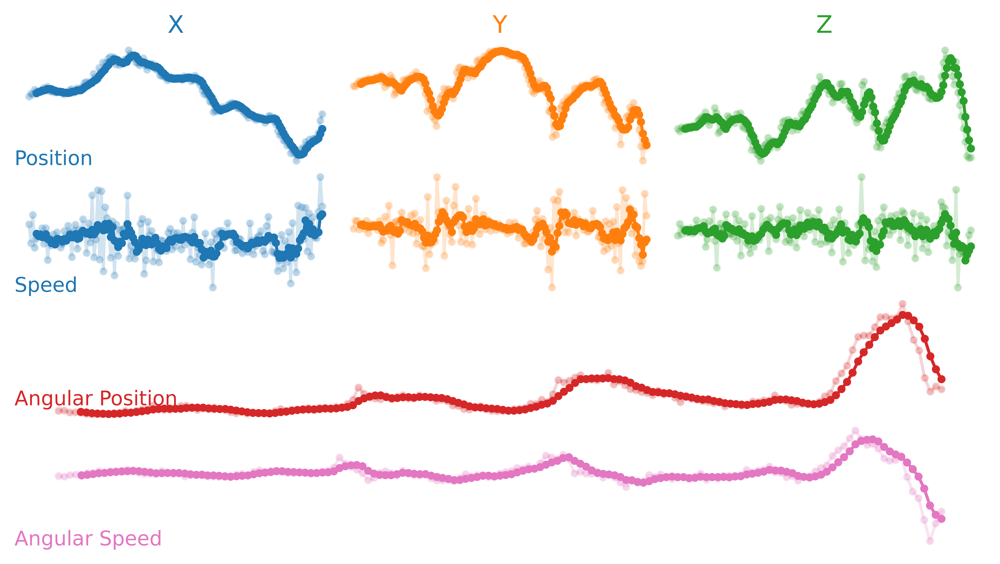

In [27]:
plt.rcParams['figure.figsize'] = (7,4)
plt.rcParams['figure.dpi'] = 1200

def common_plot_extras():
    plt.xticks([])
    plt.yticks([])
    plt.axis(False)

plt.title('Right Knee')
for j, tag in enumerate(['_x', '_y', '_z']):
    plt.subplot(4, 3, j+1)
    plt.plot(df['right_knee' + tag], marker='.', color=f'C{j}', alpha=0.2)
    plt.plot(df['right_knee' + tag].rolling(5).mean(), marker='.', color=f'C{j}')
    common_plot_extras()
    if j==0:
        plt.text(0, 0.01, 'Position', color='C0', transform=plt.gca().transAxes)

    plt.subplot(4, 3, j+4)
    plt.plot(df['right_knee' + tag].diff(), marker='.', color=f'C{j}', alpha=0.2)
    plt.plot(df['right_knee' + tag].diff().rolling(5).mean(), marker='.', color=f'C{j}')
    common_plot_extras()
    if j==0:
        plt.text(0, 0.01, 'Speed', color='C0', transform=plt.gca().transAxes)

plt.subplot(4, 3, 1)
plt.title('X', color='C0')
plt.subplot(4, 3, 2)
plt.title('Y', color='C1')
plt.subplot(4, 3, 3)
plt.title('Z', color='C2')

plt.subplot(4,1,3)
plt.plot(df['right_ankle_angle'], marker='.', color='C3', alpha=0.2)
plt.plot(df['right_ankle_angle'].rolling(5).mean(), marker='.', color='C3')
common_plot_extras()
plt.text(0, 0.12, 'Angular Position', color='C3', transform=plt.gca().transAxes)
plt.subplot(4,1,4)
plt.plot(df['right_ankle_angle'].rolling(5).mean().diff(), marker='.', color='C6', alpha=0.2)
plt.plot(df['right_ankle_angle'].rolling(5).mean().diff().rolling(5).mean(), marker='.', color='C6')
common_plot_extras()
plt.text(0, 0.01, 'Angular Speed', color='C6', transform=plt.gca().transAxes)

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/012_data_processing.pdf');

In [28]:
scores = {} # r-squared scores dict for all algorithms
scores2d = {}
correlations = {} # correlations dict for all algorithms
correlations2d = {}
for algo in ['linear_regression', 'knn', 'grad_boost', 'random_forest']:
    # 3D
    scores[algo] = round(r2_score(res_3d['speed_kmh'], res_3d['pred_' + algo]), 2)
    correlations[algo] = round(np.corrcoef(res_3d['speed_kmh'], res_3d['pred_' + algo])[0][1], 2)

    # 2D
    scores2d[algo] = round(r2_score(res_2d['speed_kmh'], res_2d['pred_' + algo]), 2)
    correlations2d[algo] = round(np.corrcoef(res_2d['speed_kmh'], res_2d['pred_' + algo])[0][1], 2)

In [29]:
plt.rcParams['figure.figsize'] = (16,9)
plt.rcParams['figure.dpi'] = 1200

plt.subplot(3,1,1)
plt.scatter(res_3d.speed_kmh, [0 for _ in res_3d.speed_kmh], label='Truth', color='C0')
plt.scatter(res_3d.pred_linear_regression, [-1 for _ in res_3d.speed_kmh], 
    label=f'Linear Regression   | R2={scores["linear_regression"]} | corr={correlations["linear_regression"]}', color='C1')
plt.scatter([25, 100], [-1, -1], s=100, color='C1', marker='D')
plt.scatter(res_3d.pred_knn, [-2 for _ in res_3d.speed_kmh], 
    label=f'K-Nearest Neighbors | R2={scores["knn"]} | corr={correlations["knn"]}', color='C2')
plt.scatter(res_3d.pred_grad_boost, [-3 for _ in res_3d.speed_kmh], 
    label=f'Gradient Boosting   | R2= {scores["grad_boost"]} | corr={correlations["grad_boost"]}', color='C3')
plt.scatter(res_3d.pred_random_forest, [-4 for _ in res_3d.speed_kmh], 
    label=f'Random Forest       | R2= {scores["random_forest"]} | corr={correlations["random_forest"]}', color='C4')

plt.xlim([25, 100])
plt.xticks([])
plt.yticks([])
plt.ylabel('Prediction w/3D', fontsize=16)

plt.legend(prop={'family': 'monospace'}, loc='lower right');


plt.subplot(3,1,2)
plt.scatter(res_2d.speed_kmh, [0 for _ in res_2d.speed_kmh], label='Truth', color='C0')
plt.scatter(res_2d.pred_linear_regression, [-1 for _ in res_2d.speed_kmh], 
    label=f'Linear Regression   | R2={scores2d["linear_regression"]} | corr={correlations2d["linear_regression"]}', color='C1')
plt.scatter([25, 100], [-1, -1], s=100, color='C1', marker='D')
plt.scatter(res_2d.pred_knn, [-2 for _ in res_2d.speed_kmh], 
    label=f'K-Nearest Neighbors | R2=  {scores2d["knn"]} | corr={correlations2d["knn"]}', color='C2')
plt.scatter(res_2d.pred_grad_boost, [-3 for _ in res_2d.speed_kmh], 
    label=f'Gradient Boosting   | R2=  {scores2d["grad_boost"]} | corr={correlations2d["grad_boost"]}', color='C3')
plt.scatter(res_2d.pred_random_forest, [-4 for _ in res_2d.speed_kmh], 
    label=f'Random Forest       | R2=  {scores2d["random_forest"]} | corr={correlations2d["random_forest"]}', color='C4')

plt.xlim([25, 100])
plt.yticks([])
plt.ylabel('Prediction w/2D', fontsize=16)

plt.legend(prop={'family': 'monospace'}, loc='lower right');


plt.subplot(3,1,3)
df_feature = pd.read_csv('results/model_importances.csv')
df_feature = df_feature.sort_values('feature_importance', ascending=False)
angle_dict = {}
for _, feature in df_feature.iloc[:int(len(df_feature)/4)].iterrows():
    feature_body_part = feature['feature'].split('_')[0] + ' ' + feature['feature'].split('_')[1] + ' ' + feature['feature'].split('_')[2]
    if feature_body_part not in angle_dict.keys():
        angle_dict[feature_body_part] = 1
    else:
        angle_dict[feature_body_part] += 1
    
angle_dict = dict(sorted(angle_dict.items(), key=lambda item: item[1], reverse=True))
for key in angle_dict.keys():
    if 'right' in key:
        plt.bar(key.replace(' angle', ''), angle_dict[key], color='C0')
    else:
        plt.bar(key.replace(' angle', ''), angle_dict[key], color='C1')
plt.ylabel('Number of features\nfrom each body part\nin the top 1st quartile', fontsize=16)

plt.tight_layout(h_pad=0.1, w_pad=0.1);
plt.savefig('figures/013_results.pdf');